# Assessment - Circle K 

### Background:
An airline company collects information on all passengers who have flown in their airlines and are interested to do an analysis of customer satisfaction. They've recorded the satisfaction of the customer over several of their in-flight services.
As a solution specialist the client has approached you to analyse the data and arrive at solution using machine learning to predict the customer satisfaction rate.
### Guidelines & Questionnaire:
    • Perform exploratory data analysis and identify the most significant variables that impact customer's satisfaction
    • Find the threshold below which a loyal customer might tend to show dissatisfaction in the overall service
    • The solution must be provided in either .pptx/.docx/.pdf/.xlsx format, not exceeding 3 pages
    • Please take any assumptions as required and point it out in the submission
    • The submission must also include the code developed for verification purposes. The code might be executed and tested during the interview

In [1]:
# Installing required libraries
!pip install pandas_profiling

     |████████████████████████████████| 262 kB 4.6 MB/s            
     |████████████████████████████████| 11.2 MB 79.7 MB/s            
  Preparing metadata (setup.py) ... done
     |████████████████████████████████| 675 kB 65.2 MB/s            
     |████████████████████████████████| 102 kB 19.2 MB/s           
     |████████████████████████████████| 292 kB 80.8 MB/s            
     |████████████████████████████████| 4.7 MB 54.7 MB/s            
     |████████████████████████████████| 261 kB 80.0 MB/s            
     |████████████████████████████████| 303 kB 91.6 MB/s            
     |████████████████████████████████| 3.1 MB 49.9 MB/s            
     |████████████████████████████████| 812 kB 48.7 MB/s            
  Preparing metadata (setup.py) ... done
  Created wheel for htmlmin: filename=htmlmin-0.1.12-py3-none-any.whl size=27098 sha256=73bf169ba7fddc6ad4c1bfbcf39f2f0db25aaf346593dd8046643eba74c264f6
  Stored in directory: /home/jovyan/.cache/pip/wheels/c3/fe/0b/4450b38bceb9a

In [2]:
# Installing required libraries
#Importing libraries
import numpy as np
import pandas as pd
import pandas_profiling as pf
#import dtale

#Visualization imports
import matplotlib.pyplot as plt
%matplotlib inline
import seaborn as sns
plt.style.use('seaborn-whitegrid')

In [3]:
#Loading dataset
df_train= pd.read_csv("train.csv", header=0)
df_test= pd.read_csv("test.csv", header=0)
print(f'The training data shape is {df_train.shape} containing {df_train.shape[0]} records and {df_train.shape[1]} variables.')
print(f'The testing data shape is {df_test.shape} containing {df_test.shape[0]} records and {df_test.shape[1]} variables.')

The training data shape is (103904, 25) containing 103904 records and 25 variables.
The testing data shape is (25976, 25) containing 25976 records and 25 variables.


In [4]:
#Merge Dataset
df = pd.concat([df_train, df_test], ignore_index = True)
print(f'After concatenating, the whole data shape is {df.shape} containing {df.shape[0]} records and {df.shape[1]} variables.')
df.head()

After concatenating, the whole data shape is (129880, 25) containing 129880 records and 25 variables.


,Unnamed: 0,id,Gender,Customer Type,Age,Type of Travel,Class,Flight Distance,Inflight wifi service,Departure/Arrival time convenient,...,Inflight entertainment,On-board service,Leg room service,Baggage handling,Checkin service,Inflight service,Cleanliness,Departure Delay in Minutes,Arrival Delay in Minutes,satisfaction
0,0,70172,Male,Loyal Customer,13,Personal Travel,Eco Plus,460,3,4,...,5,4,3,4,4,5,5,25,18.0,neutral or dissatisfied
1,1,5047,Male,disloyal Customer,25,Business travel,Business,235,3,2,...,1,1,5,3,1,4,1,1,6.0,neutral or dissatisfied
2,2,110028,Female,Loyal Customer,26,Business travel,Business,1142,2,2,...,5,4,3,4,4,4,5,0,0.0,satisfied
3,3,24026,Female,Loyal Customer,25,Business travel,Business,562,2,5,...,2,2,5,3,1,4,2,11,9.0,neutral or dissatisfied
4,4,119299,Male,Loyal Customer,61,Business travel,Business,214,3,3,...,3,3,4,4,3,3,3,0,0.0,satisfied


In [5]:
#Printing last rows
df.tail()

,Unnamed: 0,id,Gender,Customer Type,Age,Type of Travel,Class,Flight Distance,Inflight wifi service,Departure/Arrival time convenient,...,Inflight entertainment,On-board service,Leg room service,Baggage handling,Checkin service,Inflight service,Cleanliness,Departure Delay in Minutes,Arrival Delay in Minutes,satisfaction
129875,25971,78463,Male,disloyal Customer,34,Business travel,Business,526,3,3,...,4,3,2,4,4,5,4,0,0.0,neutral or dissatisfied
129876,25972,71167,Male,Loyal Customer,23,Business travel,Business,646,4,4,...,4,4,5,5,5,5,4,0,0.0,satisfied
129877,25973,37675,Female,Loyal Customer,17,Personal Travel,Eco,828,2,5,...,2,4,3,4,5,4,2,0,0.0,neutral or dissatisfied
129878,25974,90086,Male,Loyal Customer,14,Business travel,Business,1127,3,3,...,4,3,2,5,4,5,4,0,0.0,satisfied
129879,25975,34799,Female,Loyal Customer,42,Personal Travel,Eco,264,2,5,...,1,1,2,1,1,1,1,0,0.0,neutral or dissatisfied


### Task 1 : Data Analysis

In [6]:
#Generating the Profile Report of the dataset - Easiest way to get the insights of the Data
profile_report = pf.ProfileReport(df)
profile_report

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [7]:
#Get the Descriptive Stats about the Numeric data along with the categorical feature
df.describe(include='all')

,Unnamed: 0,id,Gender,Customer Type,Age,Type of Travel,Class,Flight Distance,Inflight wifi service,Departure/Arrival time convenient,...,Inflight entertainment,On-board service,Leg room service,Baggage handling,Checkin service,Inflight service,Cleanliness,Departure Delay in Minutes,Arrival Delay in Minutes,satisfaction
count,129880.000000,129880.000000,129880,129880,129880.000000,129880,129880,129880.000000,129880.000000,129880.000000,...,129880.000000,129880.000000,129880.000000,129880.000000,129880.000000,129880.000000,129880.000000,129880.000000,129487.000000,129880
unique,NaN,NaN,2,2,NaN,2,3,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2
top,NaN,NaN,Female,Loyal Customer,NaN,Business travel,Business,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,neutral or dissatisfied
freq,NaN,NaN,65899,106100,NaN,89693,62160,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,73452
mean,44158.700000,64940.500000,NaN,NaN,39.427957,NaN,NaN,1190.316392,2.728696,3.057599,...,3.358077,3.383023,3.350878,3.632114,3.306267,3.642193,3.286326,14.713713,15.091129,NaN
std,31207.377062,37493.270818,NaN,NaN,15.119360,NaN,NaN,997.452477,1.329340,1.526741,...,1.334049,1.287099,1.316252,1.180025,1.266185,1.176669,1.313682,38.071126,38.465650,NaN
min,0.000000,1.000000,NaN,NaN,7.000000,NaN,NaN,31.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,NaN
25%,16234.750000,32470.750000,NaN,NaN,27.000000,NaN,NaN,414.000000,2.000000,2.000000,...,2.000000,2.000000,2.000000,3.000000,3.000000,3.000000,2.000000,0.000000,0.000000,NaN
50%,38963.500000,64940.500000,NaN,NaN,40.000000,NaN,NaN,844.000000,3.000000,3.000000,...,4.000000,4.000000,4.000000,4.000000,3.000000,4.000000,3.000000,0.000000,0.000000,NaN
75%,71433.250000,97410.250000,NaN,NaN,51.000000,NaN,NaN,1744.000000,4.000000,4.000000,...,4.000000,4.000000,4.000000,5.000000,4.000000,5.000000,4.000000,12.000000,13.000000,NaN


### Observations:
    1. Unnamed and Id column can be removed.
    2. Gender, Customer Type, Type of Travel, Class, Satisfaction column variables seems to be the categorical variables. We can convert them to Numerics.
    3. There is a high difference between the 75% and Maximum value for the Flight Distance, Departure Delay in Minutes column,and Arrival Delay in Minutes column. Outlier analysis needs to be performed.
    4. There are columns with values ranging from 0 to 5.
    5. Arrival Delay in Minutes	column contains missing values.
    6. Target variable is satisfaction column with 2 categories.

In [8]:
# Dropping the Unnamed and ID column from the dataset
df = df.drop(columns='Unnamed: 0', axis=1)
df = df.drop(columns='id', axis=1)
print(f'Unnamed: 0 and id columns dropped.')

Unnamed: 0 and id columns dropped.


In [9]:
#Info about the dataset
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 129880 entries, 0 to 129879
Data columns (total 23 columns):
 #   Column                             Non-Null Count   Dtype  
---  ------                             --------------   -----  
 0   Gender                             129880 non-null  object 
 1   Customer Type                      129880 non-null  object 
 2   Age                                129880 non-null  int64  
 3   Type of Travel                     129880 non-null  object 
 4   Class                              129880 non-null  object 
 5   Flight Distance                    129880 non-null  int64  
 6   Inflight wifi service              129880 non-null  int64  
 7   Departure/Arrival time convenient  129880 non-null  int64  
 8   Ease of Online booking             129880 non-null  int64  
 9   Gate location                      129880 non-null  int64  
 10  Food and drink                     129880 non-null  int64  
 11  Online boarding                    1298

In [10]:
# Finding Duplicate rows
duplicate_rows_train = df_train[df_train.duplicated(keep="first")]
duplicate_rows_train

,Unnamed: 0,id,Gender,Customer Type,Age,Type of Travel,Class,Flight Distance,Inflight wifi service,Departure/Arrival time convenient,...,Inflight entertainment,On-board service,Leg room service,Baggage handling,Checkin service,Inflight service,Cleanliness,Departure Delay in Minutes,Arrival Delay in Minutes,satisfaction


In [11]:
#Verify data types
df.dtypes

Gender                                object
Customer Type                         object
Age                                    int64
Type of Travel                        object
Class                                 object
Flight Distance                        int64
Inflight wifi service                  int64
Departure/Arrival time convenient      int64
Ease of Online booking                 int64
Gate location                          int64
Food and drink                         int64
Online boarding                        int64
Seat comfort                           int64
Inflight entertainment                 int64
On-board service                       int64
Leg room service                       int64
Baggage handling                       int64
Checkin service                        int64
Inflight service                       int64
Cleanliness                            int64
Departure Delay in Minutes             int64
Arrival Delay in Minutes             float64
satisfacti

### Observation:
    1.  There are no duplicate rows in the dataset.
    2. There are no rows which needs to be converted to a datetime format.

## Visualization

In [12]:
def plot_univariate_analysis(data, var):
    
    print(f'{"-" * 5} Calculating variable count {"-" *5}')
    print(f'{df[var].value_counts()}')
    print(f'{"-" * 5} Calculating variable percentages {"-" *5}')
    print((np.round(df[var].value_counts(normalize=True), 3)*100))
    print(f'Plotting the {var} variable.')
    plt.subplot(1, 2, 1)
    df[var].value_counts().plot(kind='pie', title = var, ylabel="", autopct = '%1.2f%%', shadow = True, startangle=0.1)
    
    plt.subplot(1, 2, 2)
    sns.countplot(data[var])
    plt.tight_layout()

----- Calculating variable count -----
Female    65899
Male      63981
Name: Gender, dtype: int64
----- Calculating variable percentages -----
Female    50.7
Male      49.3
Name: Gender, dtype: float64
Plotting the Gender variable.


/srv/conda/envs/notebook/lib/python3.6/site-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


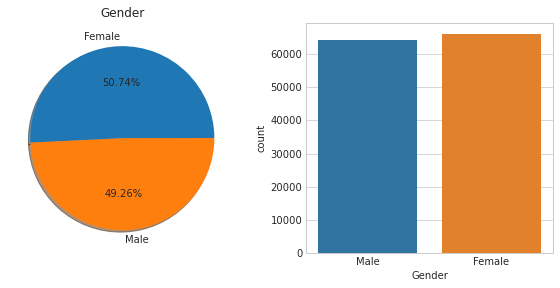

In [13]:
plt.figure(figsize=(8,4))
plot_univariate_analysis(data = df, var= 'Gender')

----- Calculating variable count -----
Loyal Customer       106100
disloyal Customer     23780
Name: Customer Type, dtype: int64
----- Calculating variable percentages -----
Loyal Customer       81.7
disloyal Customer    18.3
Name: Customer Type, dtype: float64
Plotting the Customer Type variable.


/srv/conda/envs/notebook/lib/python3.6/site-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


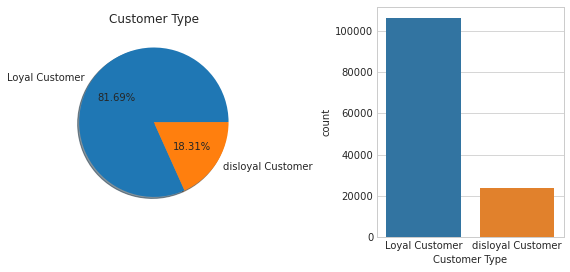

In [14]:
plt.figure(figsize=(8,4))
plot_univariate_analysis(data = df, var= 'Customer Type')

/srv/conda/envs/notebook/lib/python3.6/site-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


<AxesSubplot:xlabel='Age', ylabel='count'>

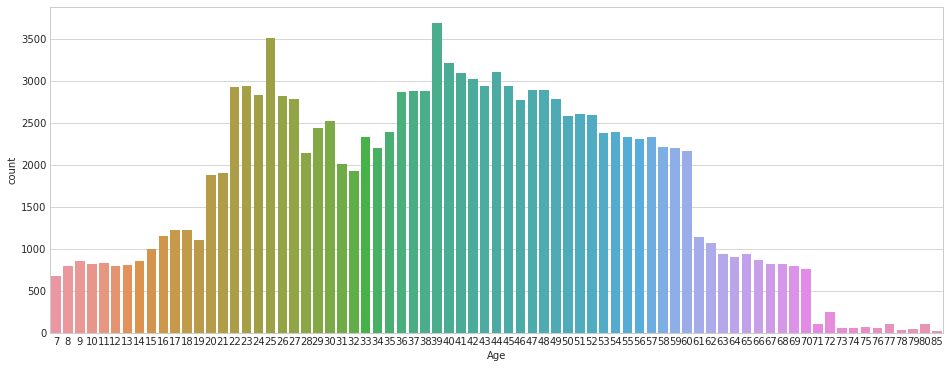

In [15]:
plt.figure(figsize=(16,6))
sns.countplot(df['Age'])

----- Calculating variable count -----
Business travel    89693
Personal Travel    40187
Name: Type of Travel, dtype: int64
----- Calculating variable percentages -----
Business travel    69.1
Personal Travel    30.9
Name: Type of Travel, dtype: float64
Plotting the Type of Travel variable.


/srv/conda/envs/notebook/lib/python3.6/site-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


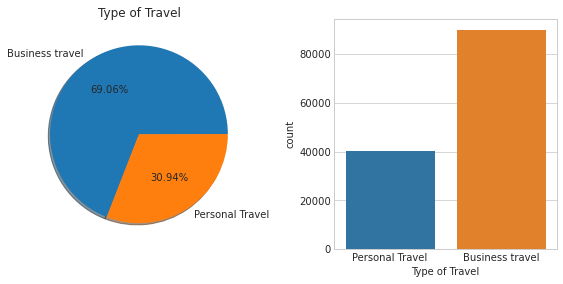

In [16]:
plt.figure(figsize=(8,4))
plot_univariate_analysis(data = df, var= 'Type of Travel')

----- Calculating variable count -----
Business    62160
Eco         58309
Eco Plus     9411
Name: Class, dtype: int64
----- Calculating variable percentages -----
Business    47.9
Eco         44.9
Eco Plus     7.2
Name: Class, dtype: float64
Plotting the Class variable.


/srv/conda/envs/notebook/lib/python3.6/site-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


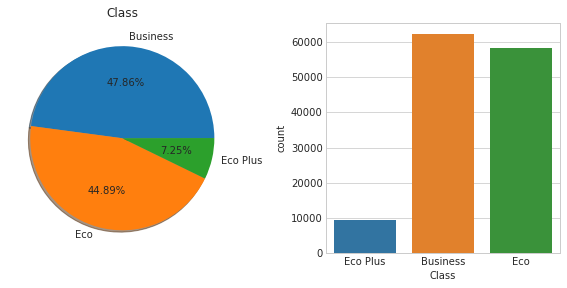

In [17]:
plt.figure(figsize=(8,4))
plot_univariate_analysis(data = df, var= 'Class')

/srv/conda/envs/notebook/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


<AxesSubplot:xlabel='Flight Distance', ylabel='Density'>

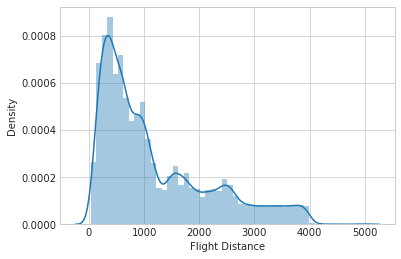

In [18]:
#plt.figure(figsize=(16,6))
sns.distplot(df['Flight Distance'])

----- Calculating variable count -----
4    31880
5    27998
3    22378
2    21534
1    19409
0     6681
Name: Departure/Arrival time convenient, dtype: int64
----- Calculating variable percentages -----
4    24.5
5    21.6
3    17.2
2    16.6
1    14.9
0     5.1
Name: Departure/Arrival time convenient, dtype: float64
Plotting the Departure/Arrival time convenient variable.


/srv/conda/envs/notebook/lib/python3.6/site-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


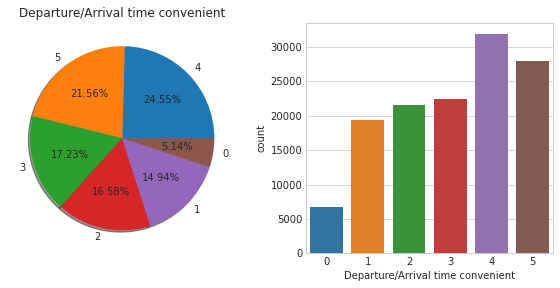

In [19]:
plt.figure(figsize=(8,4))
plot_univariate_analysis(data = df, var= 'Departure/Arrival time convenient')

----- Calculating variable count -----
3    30393
2    30051
4    24444
1    21886
5    17424
0     5682
Name: Ease of Online booking, dtype: int64
----- Calculating variable percentages -----
3    23.4
2    23.1
4    18.8
1    16.9
5    13.4
0     4.4
Name: Ease of Online booking, dtype: float64
Plotting the Ease of Online booking variable.


/srv/conda/envs/notebook/lib/python3.6/site-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


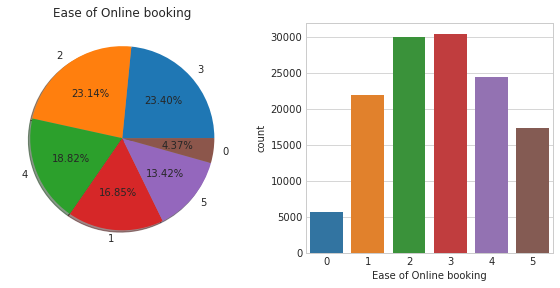

In [20]:
plt.figure(figsize=(8,4))
plot_univariate_analysis(data = df, var= 'Ease of Online booking')

----- Calculating variable count -----
3    35717
4    30466
2    24296
1    21991
5    17409
0        1
Name: Gate location, dtype: int64
----- Calculating variable percentages -----
3    27.5
4    23.5
2    18.7
1    16.9
5    13.4
0     0.0
Name: Gate location, dtype: float64
Plotting the Gate location variable.


/srv/conda/envs/notebook/lib/python3.6/site-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


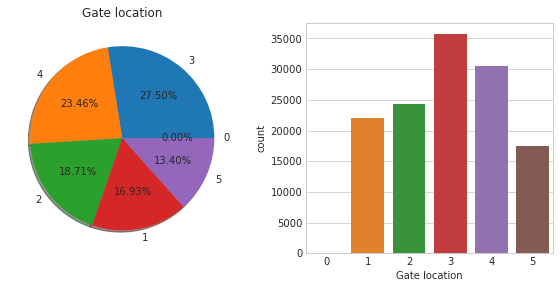

In [21]:
plt.figure(figsize=(8,4))
plot_univariate_analysis(data = df, var= 'Gate location')

----- Calculating variable count -----
4    30563
5    27957
3    27794
2    27383
1    16051
0      132
Name: Food and drink, dtype: int64
----- Calculating variable percentages -----
4    23.5
5    21.5
3    21.4
2    21.1
1    12.4
0     0.1
Name: Food and drink, dtype: float64
Plotting the Food and drink variable.


/srv/conda/envs/notebook/lib/python3.6/site-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


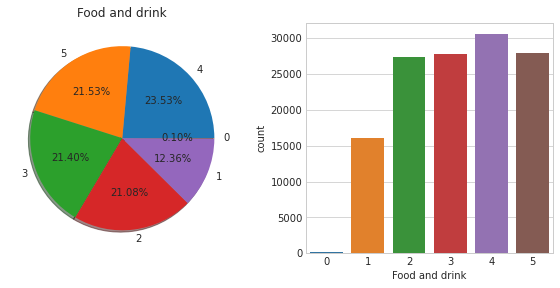

In [22]:
plt.figure(figsize=(8,4))
plot_univariate_analysis(data = df, var= 'Food and drink')

----- Calculating variable count -----
4    38468
3    27117
5    26020
2    21934
1    13261
0     3080
Name: Online boarding, dtype: int64
----- Calculating variable percentages -----
4    29.6
3    20.9
5    20.0
2    16.9
1    10.2
0     2.4
Name: Online boarding, dtype: float64
Plotting the Online boarding variable.


/srv/conda/envs/notebook/lib/python3.6/site-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


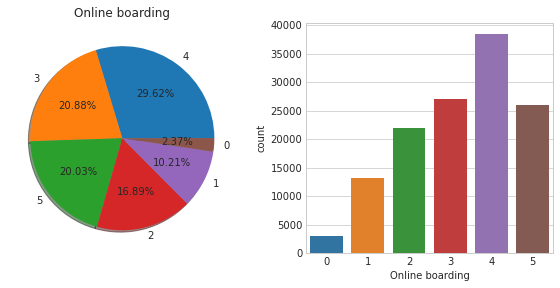

In [23]:
plt.figure(figsize=(8,4))
plot_univariate_analysis(data = df, var= 'Online boarding')

----- Calculating variable count -----
4    39756
5    33158
3    23328
2    18529
1    15108
0        1
Name: Seat comfort, dtype: int64
----- Calculating variable percentages -----
4    30.6
5    25.5
3    18.0
2    14.3
1    11.6
0     0.0
Name: Seat comfort, dtype: float64
Plotting the Seat comfort variable.


/srv/conda/envs/notebook/lib/python3.6/site-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


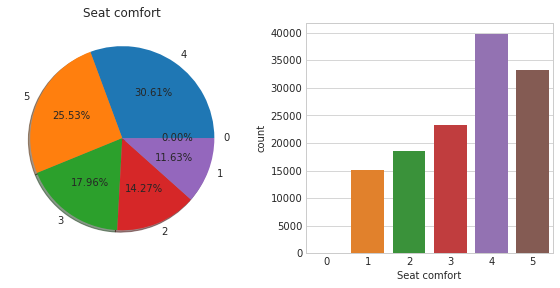

In [24]:
plt.figure(figsize=(8,4))
plot_univariate_analysis(data = df, var= 'Seat comfort')

----- Calculating variable count -----
4    36791
5    31544
3    23884
2    21968
1    15675
0       18
Name: Inflight entertainment, dtype: int64
----- Calculating variable percentages -----
4    28.3
5    24.3
3    18.4
2    16.9
1    12.1
0     0.0
Name: Inflight entertainment, dtype: float64
Plotting the Inflight entertainment variable.


/srv/conda/envs/notebook/lib/python3.6/site-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


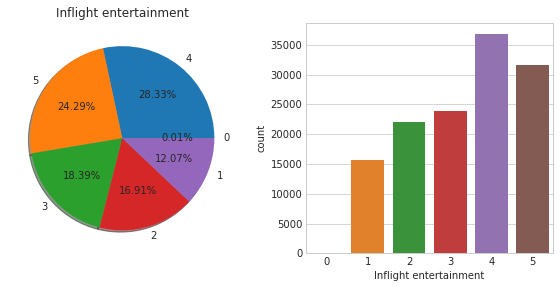

In [25]:
plt.figure(figsize=(8,4))
plot_univariate_analysis(data = df, var= 'Inflight entertainment')

----- Calculating variable count -----
4    38703
5    29492
3    28542
2    18351
1    14787
0        5
Name: On-board service, dtype: int64
----- Calculating variable percentages -----
4    29.8
5    22.7
3    22.0
2    14.1
1    11.4
0     0.0
Name: On-board service, dtype: float64
Plotting the On-board service variable.


/srv/conda/envs/notebook/lib/python3.6/site-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


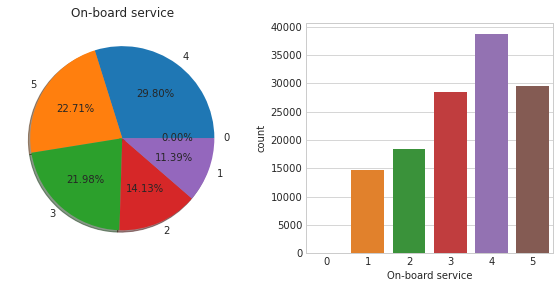

In [26]:
plt.figure(figsize=(8,4))
plot_univariate_analysis(data = df, var= 'On-board service')

----- Calculating variable count -----
4    35886
5    30905
3    25056
2    24540
1    12895
0      598
Name: Leg room service, dtype: int64
----- Calculating variable percentages -----
4    27.6
5    23.8
3    19.3
2    18.9
1     9.9
0     0.5
Name: Leg room service, dtype: float64
Plotting the Leg room service variable.


/srv/conda/envs/notebook/lib/python3.6/site-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


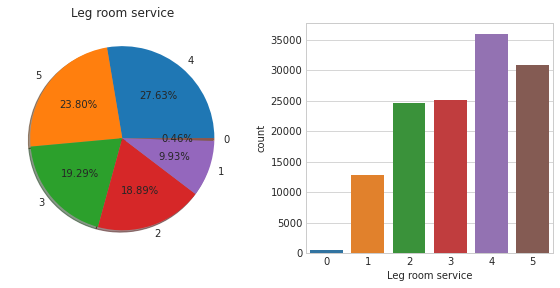

In [27]:
plt.figure(figsize=(8,4))
plot_univariate_analysis(data = df, var= 'Leg room service')

----- Calculating variable count -----
4    46761
5    33878
3    25851
2    14362
1     9028
Name: Baggage handling, dtype: int64
----- Calculating variable percentages -----
4    36.0
5    26.1
3    19.9
2    11.1
1     7.0
Name: Baggage handling, dtype: float64
Plotting the Baggage handling variable.


/srv/conda/envs/notebook/lib/python3.6/site-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


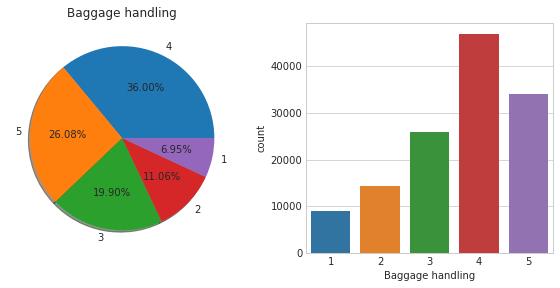

In [28]:
plt.figure(figsize=(8,4))
plot_univariate_analysis(data = df, var= 'Baggage handling')

----- Calculating variable count -----
4    36333
3    35453
5    25883
1    16108
2    16102
0        1
Name: Checkin service, dtype: int64
----- Calculating variable percentages -----
4    28.0
3    27.3
5    19.9
1    12.4
2    12.4
0     0.0
Name: Checkin service, dtype: float64
Plotting the Checkin service variable.


/srv/conda/envs/notebook/lib/python3.6/site-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


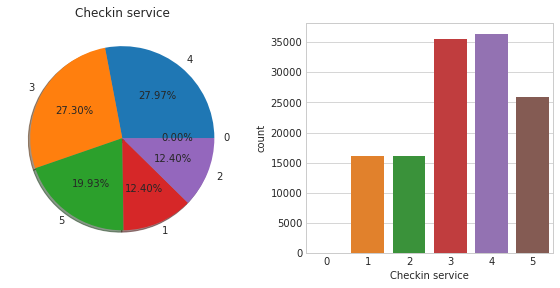

In [29]:
plt.figure(figsize=(8,4))
plot_univariate_analysis(data = df, var= 'Checkin service')

----- Calculating variable count -----
4    47323
5    34066
3    25316
2    14308
1     8862
0        5
Name: Inflight service, dtype: int64
----- Calculating variable percentages -----
4    36.4
5    26.2
3    19.5
2    11.0
1     6.8
0     0.0
Name: Inflight service, dtype: float64
Plotting the Inflight service variable.


/srv/conda/envs/notebook/lib/python3.6/site-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


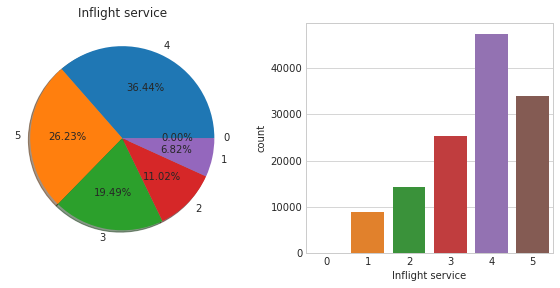

In [30]:
plt.figure(figsize=(8,4))
plot_univariate_analysis(data = df, var= 'Inflight service')

----- Calculating variable count -----
4    33969
3    30639
5    28416
2    20113
1    16729
0       14
Name: Cleanliness, dtype: int64
----- Calculating variable percentages -----
4    26.2
3    23.6
5    21.9
2    15.5
1    12.9
0     0.0
Name: Cleanliness, dtype: float64
Plotting the Cleanliness variable.


/srv/conda/envs/notebook/lib/python3.6/site-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


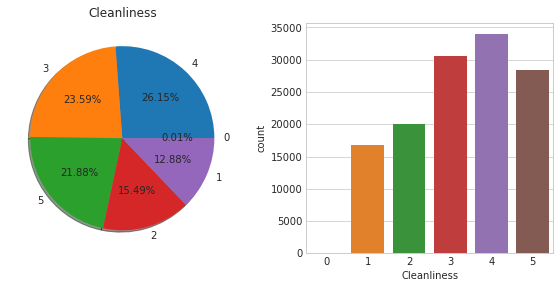

In [31]:
plt.figure(figsize=(8,4))
plot_univariate_analysis(data = df, var= 'Cleanliness')

### Bivariate Analysis

In [32]:
def plot_bivariate_analysis(data, var1, var2):
    print(df.groupby([var1])[var2].value_counts())
    print(f'Plotting the {var1} variable with the {var2} variable.')
    
    # count Gender column with target Variable - satisfaction
    sns.countplot(y = var1, hue = var2, data = data)

Gender  satisfaction           
Female  neutral or dissatisfied    37630
        satisfied                  28269
Male    neutral or dissatisfied    35822
        satisfied                  28159
Name: satisfaction, dtype: int64
Plotting the Gender variable with the satisfaction variable.


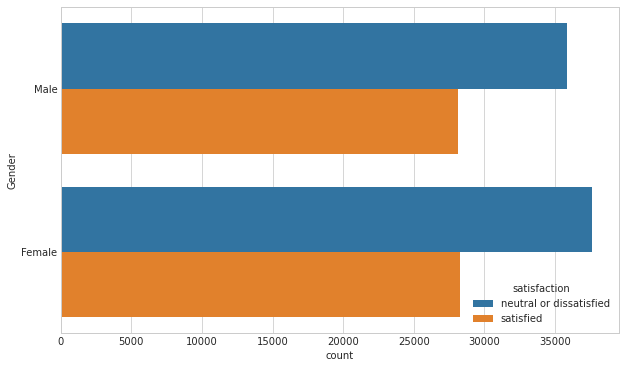

In [33]:
plt.figure(figsize=(10,6))
plot_bivariate_analysis(data = df, var1= 'Gender', var2 = 'satisfaction')

Customer Type      satisfaction           
Loyal Customer     neutral or dissatisfied    55372
                   satisfied                  50728
disloyal Customer  neutral or dissatisfied    18080
                   satisfied                   5700
Name: satisfaction, dtype: int64
Plotting the Customer Type variable with the satisfaction variable.


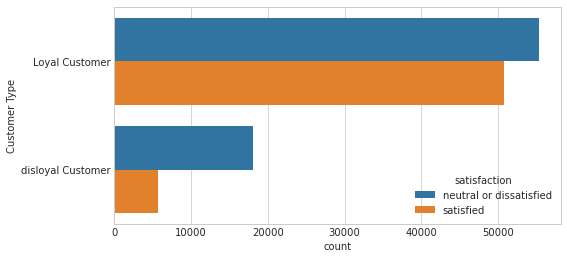

In [34]:
plt.figure(figsize=(8,4))
plot_bivariate_analysis(data = df, var1= 'Customer Type', var2 = 'satisfaction')

Class     satisfaction           
Business  satisfied                  43166
          neutral or dissatisfied    18994
Eco       neutral or dissatisfied    47366
          satisfied                  10943
Eco Plus  neutral or dissatisfied     7092
          satisfied                   2319
Name: satisfaction, dtype: int64
Plotting the Class variable with the satisfaction variable.


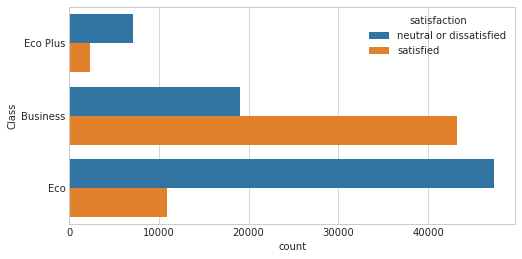

In [35]:
plt.figure(figsize=(8,4))
plot_bivariate_analysis(data = df, var1= 'Class', var2 = 'satisfaction')

Seat comfort  satisfaction           
0             neutral or dissatisfied        1
1             neutral or dissatisfied    11734
              satisfied                   3374
2             neutral or dissatisfied    14341
              satisfied                   4188
3             neutral or dissatisfied    18334
              satisfied                   4994
4             satisfied                  22275
              neutral or dissatisfied    17481
5             satisfied                  21597
              neutral or dissatisfied    11561
Name: satisfaction, dtype: int64
Plotting the Seat comfort variable with the satisfaction variable.


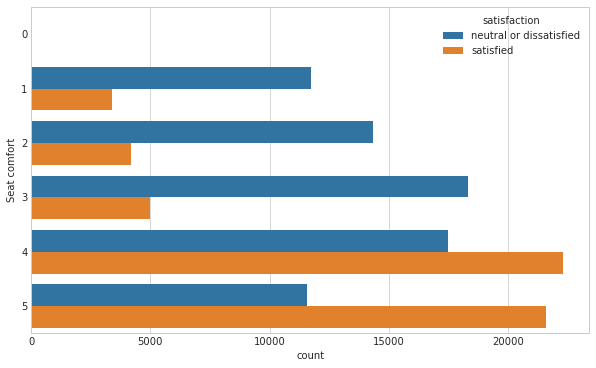

In [36]:
plt.figure(figsize=(10,6))
plot_bivariate_analysis(data = df, var1= 'Seat comfort', var2 = 'satisfaction')

Gate location  satisfaction           
0              satisfied                      1
1              neutral or dissatisfied    11020
               satisfied                  10971
2              neutral or dissatisfied    13028
               satisfied                  11268
3              neutral or dissatisfied    23321
               satisfied                  12396
4              neutral or dissatisfied    18563
               satisfied                  11903
5              satisfied                   9889
               neutral or dissatisfied     7520
Name: satisfaction, dtype: int64
Plotting the Gate location variable with the satisfaction variable.


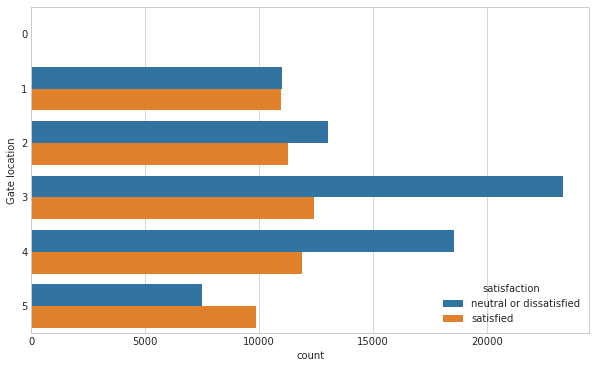

In [37]:
plt.figure(figsize=(10,6))
plot_bivariate_analysis(data = df, var1= 'Gate location', var2 = 'satisfaction')

### Missing value Analysis

In [38]:
# Identifying Missing Values
df.isnull().sum()

Gender                                 0
Customer Type                          0
Age                                    0
Type of Travel                         0
Class                                  0
Flight Distance                        0
Inflight wifi service                  0
Departure/Arrival time convenient      0
Ease of Online booking                 0
Gate location                          0
Food and drink                         0
Online boarding                        0
Seat comfort                           0
Inflight entertainment                 0
On-board service                       0
Leg room service                       0
Baggage handling                       0
Checkin service                        0
Inflight service                       0
Cleanliness                            0
Departure Delay in Minutes             0
Arrival Delay in Minutes             393
satisfaction                           0
dtype: int64

### Observation - 
    No missing values except Arrival Delay in Minutes column

In [39]:
arrival_delay_unq = df['Arrival Delay in Minutes'].nunique()
print(f'There are {arrival_delay_unq} unique values in the Arrival Delay in Minutes column for the training dataset')

There are 472 unique values in the Arrival Delay in Minutes column for the training dataset


In [40]:
# looking at the missing values of the 'Arrival Delay in Minutes' column
df[df['Arrival Delay in Minutes'].isnull()]

,Gender,Customer Type,Age,Type of Travel,Class,Flight Distance,Inflight wifi service,Departure/Arrival time convenient,Ease of Online booking,Gate location,...,Inflight entertainment,On-board service,Leg room service,Baggage handling,Checkin service,Inflight service,Cleanliness,Departure Delay in Minutes,Arrival Delay in Minutes,satisfaction
213,Female,Loyal Customer,38,Business travel,Eco,109,5,3,3,3,...,5,5,2,4,1,1,5,31,NaN,satisfied
1124,Male,Loyal Customer,53,Personal Travel,Eco,1012,3,2,3,4,...,4,4,4,4,3,3,4,38,NaN,neutral or dissatisfied
1529,Male,Loyal Customer,39,Business travel,Business,733,2,5,5,5,...,2,2,2,2,2,2,3,11,NaN,neutral or dissatisfied
2004,Female,disloyal Customer,26,Business travel,Business,1035,3,3,3,1,...,2,3,3,4,5,5,2,41,NaN,neutral or dissatisfied
2108,Female,Loyal Customer,24,Personal Travel,Eco,417,2,1,2,2,...,5,1,4,2,1,2,5,1,NaN,neutral or dissatisfied
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
127976,Male,Loyal Customer,45,Business travel,Eco,352,5,1,1,1,...,5,1,1,1,3,2,5,26,NaN,satisfied
128037,Female,Loyal Customer,29,Business travel,Business,3873,3,3,3,3,...,3,3,4,4,4,3,3,19,NaN,neutral or dissatisfied
128205,Male,disloyal Customer,38,Business travel,Business,759,3,3,3,1,...,4,3,3,5,5,4,4,0,NaN,satisfied
129032,Female,Loyal Customer,52,Business travel,Business,3659,5,5,5,5,...,5,5,5,5,3,5,3,0,NaN,satisfied


In [41]:
#Calculating mean, Median and Mode for the 'Arrival Delay in Minutes' column and finding the values to preserve the distribution shown by them
med = df['Arrival Delay in Minutes'].median()
mean = df['Arrival Delay in Minutes'].mean()
print(f' Mean : {mean} , Median : {med}')

 Mean : 15.09112883918849 , Median : 0.0


In [42]:
#Calculating Median for temp column and filling it
val_count = df['Arrival Delay in Minutes'].value_counts()
val_count.head(20)

0.0     72753
1.0      2747
2.0      2587
3.0      2442
4.0      2373
5.0      2083
6.0      2021
7.0      1794
8.0      1751
9.0      1566
10.0     1466
11.0     1438
12.0     1359
13.0     1340
14.0     1159
15.0     1050
17.0     1042
16.0     1037
18.0      938
19.0      884
Name: Arrival Delay in Minutes, dtype: int64

In [43]:
# Imputing Median - As there are 50% of the data with majority (or most frequent) as 0.0 
df['arrival_delay_minutes_median']= df['Arrival Delay in Minutes'].fillna(med)
df.head()

,Gender,Customer Type,Age,Type of Travel,Class,Flight Distance,Inflight wifi service,Departure/Arrival time convenient,Ease of Online booking,Gate location,...,On-board service,Leg room service,Baggage handling,Checkin service,Inflight service,Cleanliness,Departure Delay in Minutes,Arrival Delay in Minutes,satisfaction,arrival_delay_minutes_median
0,Male,Loyal Customer,13,Personal Travel,Eco Plus,460,3,4,3,1,...,4,3,4,4,5,5,25,18.0,neutral or dissatisfied,18.0
1,Male,disloyal Customer,25,Business travel,Business,235,3,2,3,3,...,1,5,3,1,4,1,1,6.0,neutral or dissatisfied,6.0
2,Female,Loyal Customer,26,Business travel,Business,1142,2,2,2,2,...,4,3,4,4,4,5,0,0.0,satisfied,0.0
3,Female,Loyal Customer,25,Business travel,Business,562,2,5,5,5,...,2,5,3,1,4,2,11,9.0,neutral or dissatisfied,9.0
4,Male,Loyal Customer,61,Business travel,Business,214,3,3,3,3,...,3,4,4,3,3,3,0,0.0,satisfied,0.0


In [44]:
#looking at the missing values of the Arrival Delay in Minutes column with imputed arrival_delay_minutes_median column
df[df['Arrival Delay in Minutes'].isnull()]

,Gender,Customer Type,Age,Type of Travel,Class,Flight Distance,Inflight wifi service,Departure/Arrival time convenient,Ease of Online booking,Gate location,...,On-board service,Leg room service,Baggage handling,Checkin service,Inflight service,Cleanliness,Departure Delay in Minutes,Arrival Delay in Minutes,satisfaction,arrival_delay_minutes_median
213,Female,Loyal Customer,38,Business travel,Eco,109,5,3,3,3,...,5,2,4,1,1,5,31,NaN,satisfied,0.0
1124,Male,Loyal Customer,53,Personal Travel,Eco,1012,3,2,3,4,...,4,4,4,3,3,4,38,NaN,neutral or dissatisfied,0.0
1529,Male,Loyal Customer,39,Business travel,Business,733,2,5,5,5,...,2,2,2,2,2,3,11,NaN,neutral or dissatisfied,0.0
2004,Female,disloyal Customer,26,Business travel,Business,1035,3,3,3,1,...,3,3,4,5,5,2,41,NaN,neutral or dissatisfied,0.0
2108,Female,Loyal Customer,24,Personal Travel,Eco,417,2,1,2,2,...,1,4,2,1,2,5,1,NaN,neutral or dissatisfied,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
127976,Male,Loyal Customer,45,Business travel,Eco,352,5,1,1,1,...,1,1,1,3,2,5,26,NaN,satisfied,0.0
128037,Female,Loyal Customer,29,Business travel,Business,3873,3,3,3,3,...,3,4,4,4,3,3,19,NaN,neutral or dissatisfied,0.0
128205,Male,disloyal Customer,38,Business travel,Business,759,3,3,3,1,...,3,3,5,5,4,4,0,NaN,satisfied,0.0
129032,Female,Loyal Customer,52,Business travel,Business,3659,5,5,5,5,...,5,5,5,3,5,3,0,NaN,satisfied,0.0


/srv/conda/envs/notebook/lib/python3.6/site-packages/ipykernel_launcher.py:4: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  after removing the cwd from sys.path.


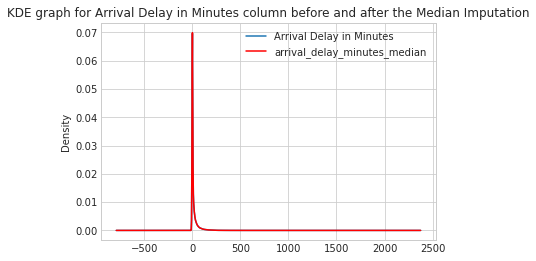

In [45]:
#Building KDE distributions to check about the distributions after imputing the missing values
fig = plt.figure()
plt.title("KDE graph for Arrival Delay in Minutes column before and after the Median Imputation")
ax = fig.add_subplot(111)
df['Arrival Delay in Minutes'].plot(kind='kde', ax=ax)
df['arrival_delay_minutes_median'].plot(kind='kde', ax=ax, color='red')
lines, labels = ax.get_legend_handles_labels()
ax.legend(lines, labels, loc='best')

In [46]:
# As both the graphs are inseparable, we can say that the data has been imputed properly

#Dropping the Arrival Delay in Minutes column
df.drop('Arrival Delay in Minutes', inplace=True, axis=1)
df.head()

,Gender,Customer Type,Age,Type of Travel,Class,Flight Distance,Inflight wifi service,Departure/Arrival time convenient,Ease of Online booking,Gate location,...,Inflight entertainment,On-board service,Leg room service,Baggage handling,Checkin service,Inflight service,Cleanliness,Departure Delay in Minutes,satisfaction,arrival_delay_minutes_median
0,Male,Loyal Customer,13,Personal Travel,Eco Plus,460,3,4,3,1,...,5,4,3,4,4,5,5,25,neutral or dissatisfied,18.0
1,Male,disloyal Customer,25,Business travel,Business,235,3,2,3,3,...,1,1,5,3,1,4,1,1,neutral or dissatisfied,6.0
2,Female,Loyal Customer,26,Business travel,Business,1142,2,2,2,2,...,5,4,3,4,4,4,5,0,satisfied,0.0
3,Female,Loyal Customer,25,Business travel,Business,562,2,5,5,5,...,2,2,5,3,1,4,2,11,neutral or dissatisfied,9.0
4,Male,Loyal Customer,61,Business travel,Business,214,3,3,3,3,...,3,3,4,4,3,3,3,0,satisfied,0.0


### Outlier Analysis

The column having the maximum value much higher than the min, 0%, 25%, 50%, 75% of the data will be termed as outliers.

In [47]:
df.describe(include="all")

,Gender,Customer Type,Age,Type of Travel,Class,Flight Distance,Inflight wifi service,Departure/Arrival time convenient,Ease of Online booking,Gate location,...,Inflight entertainment,On-board service,Leg room service,Baggage handling,Checkin service,Inflight service,Cleanliness,Departure Delay in Minutes,satisfaction,arrival_delay_minutes_median
count,129880,129880,129880.000000,129880,129880,129880.000000,129880.000000,129880.000000,129880.000000,129880.000000,...,129880.000000,129880.000000,129880.000000,129880.000000,129880.000000,129880.000000,129880.000000,129880.000000,129880,129880.000000
unique,2,2,NaN,2,3,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2,NaN
top,Female,Loyal Customer,NaN,Business travel,Business,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,neutral or dissatisfied,NaN
freq,65899,106100,NaN,89693,62160,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,73452,NaN
mean,NaN,NaN,39.427957,NaN,NaN,1190.316392,2.728696,3.057599,2.756876,2.976925,...,3.358077,3.383023,3.350878,3.632114,3.306267,3.642193,3.286326,14.713713,NaN,15.045465
std,NaN,NaN,15.119360,NaN,NaN,997.452477,1.329340,1.526741,1.401740,1.278520,...,1.334049,1.287099,1.316252,1.180025,1.266185,1.176669,1.313682,38.071126,NaN,38.416353
min,NaN,NaN,7.000000,NaN,NaN,31.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,NaN,0.000000
25%,NaN,NaN,27.000000,NaN,NaN,414.000000,2.000000,2.000000,2.000000,2.000000,...,2.000000,2.000000,2.000000,3.000000,3.000000,3.000000,2.000000,0.000000,NaN,0.000000
50%,NaN,NaN,40.000000,NaN,NaN,844.000000,3.000000,3.000000,3.000000,3.000000,...,4.000000,4.000000,4.000000,4.000000,3.000000,4.000000,3.000000,0.000000,NaN,0.000000
75%,NaN,NaN,51.000000,NaN,NaN,1744.000000,4.000000,4.000000,4.000000,4.000000,...,4.000000,4.000000,4.000000,5.000000,4.000000,5.000000,4.000000,12.000000,NaN,13.000000


<AxesSubplot:xlabel='Age'>

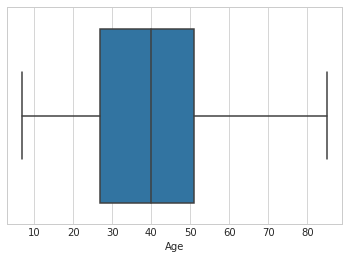

In [48]:
# Age column 
sns.boxplot(x=df['Age'])

/srv/conda/envs/notebook/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


<AxesSubplot:xlabel='Age', ylabel='Density'>

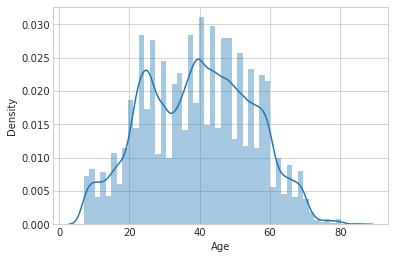

In [49]:
sns.distplot(df.Age)

<AxesSubplot:xlabel='Departure Delay in Minutes'>

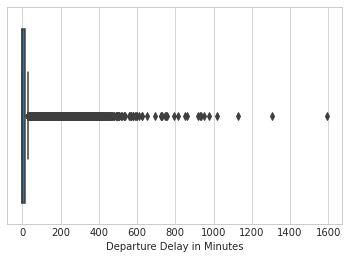

In [50]:
# Departure Delay in Minutes column
sns.boxplot(x=df['Departure Delay in Minutes'])

In [51]:
def iqr_calculation(data):
    quantile1, quantile3= np.percentile(data,[25,75])
    print(f'Q1: {quantile1}, Q3: {quantile3}')
    ## Find the IQR

    iqr_value=quantile3-quantile1
    print(f'IQR_value: {iqr_value}')
    ## Find the lower bound value and the higher bound value

    lower_bound_val = quantile1 -(1.5 * iqr_value) 
    upper_bound_val = quantile3 +(1.5 * iqr_value) 
    print(f'Lower bound value: {lower_bound_val}, Upper bound value: {upper_bound_val}')
    
    lower_extreme_val = quantile1 -(3 * iqr_value) 
    upper_extreme_val = quantile3 +(3 * iqr_value) 
    print(f'Lower extreme value: {lower_extreme_val}, Upper Extreme value: {upper_extreme_val}')

In [52]:
iqr_calculation(df_train['Departure Delay in Minutes'])

Q1: 0.0, Q3: 12.0
IQR_value: 12.0
Lower bound value: -18.0, Upper bound value: 30.0
Lower extreme value: -36.0, Upper Extreme value: 48.0


In [53]:
def treat_outliers_using_flooring_capping(df_with_var):
    median_value = df_with_var.quantile(0.50)
    print(median_value)
    extreme_value = df_with_var.quantile(0.95)
    print(extreme_value) 
    df_with_var = np.where(df_with_var> extreme_value, median_value, df_with_var)
    return df_with_var

In [54]:
dep_delay_median_value = df['Departure Delay in Minutes'].quantile(0.50)
print(dep_delay_median_value)
dep_delay_extreme_value = df['Departure Delay in Minutes'].quantile(0.95)
print(dep_delay_extreme_value) 
df['Departure Delay in Minutes'] = np.where(df['Departure Delay in Minutes']> dep_delay_extreme_value, dep_delay_median_value, df['Departure Delay in Minutes'])

0.0
77.0


<AxesSubplot:xlabel='Departure Delay in Minutes'>

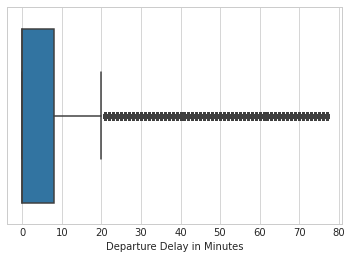

In [55]:
sns.boxplot(x=df['Departure Delay in Minutes'])

<AxesSubplot:xlabel='Flight Distance'>

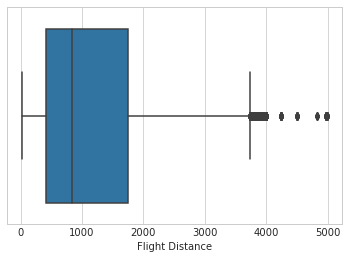

In [56]:
# Departure Delay in Minutes column
sns.boxplot(x=df['Flight Distance'])

In [57]:
iqr_calculation(df['Flight Distance'])

Q1: 414.0, Q3: 1744.0
IQR_value: 1330.0
Lower bound value: -1581.0, Upper bound value: 3739.0
Lower extreme value: -3576.0, Upper Extreme value: 5734.0


In [58]:
flt_dist_median_value = df['Flight Distance'].quantile(0.50)
print(flt_dist_median_value)
flt_dist_extreme_value = df['Flight Distance'].quantile(0.95)
print(flt_dist_extreme_value) 
df['Flight Distance'] = np.where(df['Flight Distance']> flt_dist_extreme_value, flt_dist_median_value, df['Flight Distance'])

844.0
3380.0


<AxesSubplot:xlabel='Flight Distance'>

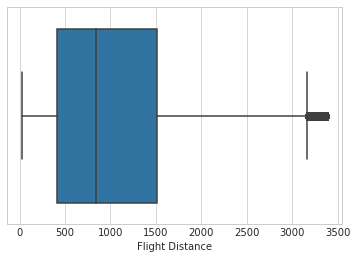

In [59]:
sns.boxplot(x=df['Flight Distance'])

In [60]:
#treat_outliers_using_flooring_capping(df_train['Departure Delay in Minutes'])

In [61]:
iqr_calculation(df['arrival_delay_minutes_median'])

Q1: 0.0, Q3: 13.0
IQR_value: 13.0
Lower bound value: -19.5, Upper bound value: 32.5
Lower extreme value: -39.0, Upper Extreme value: 52.0


<AxesSubplot:xlabel='arrival_delay_minutes_median'>

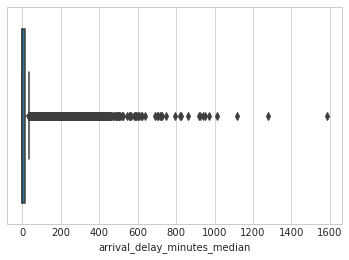

In [62]:
# Outlier Analysis - 
#The maximum value will be much higher than the min, 0%, 25%, 50%, 75% of the data. This column will have outliers.
sns.boxplot(x=df['arrival_delay_minutes_median'])

In [63]:
iqr_calculation(df['arrival_delay_minutes_median'])

Q1: 0.0, Q3: 13.0
IQR_value: 13.0
Lower bound value: -19.5, Upper bound value: 32.5
Lower extreme value: -39.0, Upper Extreme value: 52.0


In [64]:
arr_delay_median_value = df['arrival_delay_minutes_median'].quantile(0.50)
print(arr_delay_median_value)
arr_delay_extreme_value = df['arrival_delay_minutes_median'].quantile(0.95)
print(arr_delay_extreme_value) 
df['arrival_delay_minutes_median'] = np.where(df['arrival_delay_minutes_median']> arr_delay_extreme_value, arr_delay_median_value, df['arrival_delay_minutes_median'])

0.0
78.0


/srv/conda/envs/notebook/lib/python3.6/site-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


<AxesSubplot:xlabel='arrival_delay_minutes_median'>

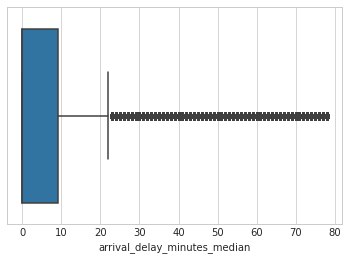

In [65]:
sns.boxplot(df['arrival_delay_minutes_median'])

In [66]:
df.describe()

,Age,Flight Distance,Inflight wifi service,Departure/Arrival time convenient,Ease of Online booking,Gate location,Food and drink,Online boarding,Seat comfort,Inflight entertainment,On-board service,Leg room service,Baggage handling,Checkin service,Inflight service,Cleanliness,Departure Delay in Minutes,arrival_delay_minutes_median
count,129880.000000,129880.000000,129880.000000,129880.000000,129880.000000,129880.000000,129880.000000,129880.000000,129880.000000,129880.000000,129880.000000,129880.000000,129880.000000,129880.000000,129880.000000,129880.000000,129880.000000,129880.000000
mean,39.427957,1047.304389,2.728696,3.057599,2.756876,2.976925,3.204774,3.252633,3.441361,3.358077,3.383023,3.350878,3.632114,3.306267,3.642193,3.286326,7.563335,7.789144
std,15.119360,813.756806,1.329340,1.526741,1.401740,1.278520,1.329933,1.350719,1.319289,1.334049,1.287099,1.316252,1.180025,1.266185,1.176669,1.313682,14.998406,15.171493
min,7.000000,31.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,27.000000,414.000000,2.000000,2.000000,2.000000,2.000000,2.000000,2.000000,2.000000,2.000000,2.000000,2.000000,3.000000,3.000000,3.000000,2.000000,0.000000,0.000000
50%,40.000000,844.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,4.000000,4.000000,4.000000,4.000000,4.000000,3.000000,4.000000,3.000000,0.000000,0.000000
75%,51.000000,1513.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,5.000000,4.000000,4.000000,4.000000,5.000000,4.000000,5.000000,4.000000,8.000000,9.000000
max,85.000000,3380.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,77.000000,78.000000


Observation;
1. There is a reduction in the difference between the 75% and the Maximum values for the Flight Distance, Arrival and Depoarture time in minutes column.

## Multicollinearity Removal

<AxesSubplot:>

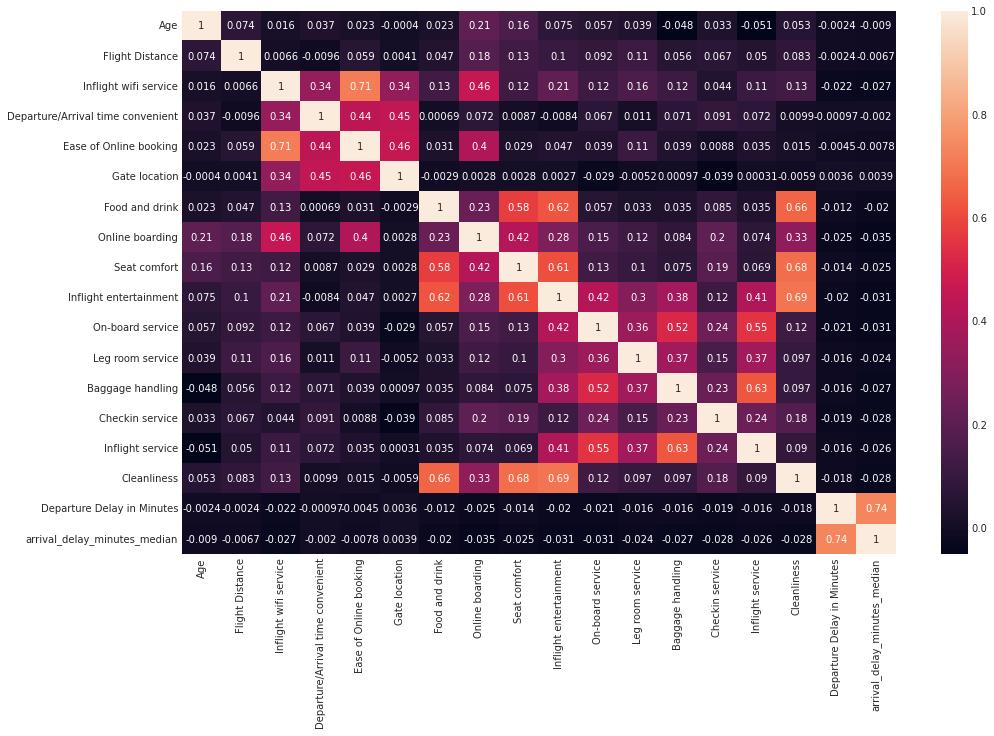

In [67]:
# Checking Multicollinearity
plt.figure(figsize=(16,10))
sns.heatmap(df.corr(), annot=True)

### Observations:
For Coorelation coefficient greater than 0.7 (or below -0.7):
1. Inflight Wifi service seems to be correlated to the Ease of Online booking variable (as Coorlation coefficient greater than 0.7).
2. Arrival delay minutes median variable seems to be correlated to the Departure Delay in Minutes(as Coorlation coefficient greater than 0.7)

In [68]:
# Dropping the Inflight Wifi service from the training dataset.
df = df.drop(columns=['Inflight wifi service', 'Departure Delay in Minutes'], axis=1)
df.head()

,Gender,Customer Type,Age,Type of Travel,Class,Flight Distance,Departure/Arrival time convenient,Ease of Online booking,Gate location,Food and drink,...,Seat comfort,Inflight entertainment,On-board service,Leg room service,Baggage handling,Checkin service,Inflight service,Cleanliness,satisfaction,arrival_delay_minutes_median
0,Male,Loyal Customer,13,Personal Travel,Eco Plus,460.0,4,3,1,5,...,5,5,4,3,4,4,5,5,neutral or dissatisfied,18.0
1,Male,disloyal Customer,25,Business travel,Business,235.0,2,3,3,1,...,1,1,1,5,3,1,4,1,neutral or dissatisfied,6.0
2,Female,Loyal Customer,26,Business travel,Business,1142.0,2,2,2,5,...,5,5,4,3,4,4,4,5,satisfied,0.0
3,Female,Loyal Customer,25,Business travel,Business,562.0,5,5,5,2,...,2,2,2,5,3,1,4,2,neutral or dissatisfied,9.0
4,Male,Loyal Customer,61,Business travel,Business,214.0,3,3,3,4,...,5,3,3,4,4,3,3,3,satisfied,0.0


## Cleaned data

In [69]:
# Cleaned data - To CSV
df_cleaned = df.to_csv('cleaned_data.csv', index=False)

# Observations from dataset:
    A.  Customer Demographic Data
        Age
        Gender: Female, Male
        Customer Type: Loyal customer, Disloyal customer
        Type of Travel: Personal Travel, Business Travel

    B. In-flight Experiences (*Satisfaction level: 0 = Not Applicable, 1-5)
        Inflight wifi service* - (Dropped due to multicollinearity)
        Food and drink*
        Seat comfort*
        Inflight entertainment*
        Leg room service*
        Inflight service*
        Cleanliness*

    C. Flight Information & Experiences (*Satisfaction level: 0 = Not Applicable, 1-5)
        Class: Business, Eco, Eco Plus
        Flight distance
        Departure/Arrival time convenient* 
        Ease of Online booking*
        Gate location*
        Online boarding*
        On-board service*
        Baggage handling*
        Check-in service*
        Departure Delay in Minutes
        Arrival Delay in Minutes - (Dropped due to multicollinearity)